In [1]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "0" 
# os.environ['http_proxy'] = 'http://10.16.35.10:13390' 
# os.environ['https_proxy'] = 'http://10.16.35.10:13390' 

import torch
from torch import nn
import torch.nn.functional as F

import sys
sys.path.append('..')
from prior_networks import UViT_Clip
from prior_pipe import PriorPipe
# from dataset import *
from utils import *

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# load prior diffusion

In [2]:
diffusion_prior = UViT_Clip(embed_dim=512, num_heads=8, mlp_ratio=4)
# number of parameters
sum(p.numel() for p in diffusion_prior.parameters() if p.requires_grad)
pipe = PriorPipe(diffusion_prior, device=device)
# load pretrained model
model_name = 'uvit_vice_pred_imagenet' 
path = f'../ckpts/{model_name}'
pipe.diffusion_prior.load_state_dict(torch.load(f'{path}.pt'))
# pipe.ema.load_state_dict(torch.load(f'{path}_ema.pt'))

<All keys matched successfully>

# load sd

In [3]:
# extract image features
from diffusers.utils import load_image
from IPython.display import Image, display
from customized_pipe import Generator4Embeds, encode_image
from transformers import CLIPVisionModelWithProjection, CLIPImageProcessor
import torch

feature_extractor = CLIPImageProcessor()
image_encoder = CLIPVisionModelWithProjection.from_pretrained(
    "h94/IP-Adapter", 
    subfolder="models/image_encoder",
    torch_dtype=torch.float16,
).to("cuda")

pipe_image = Generator4Embeds(path='stabilityai/sdxl-turbo', num_inference_steps=4)
# pipe_image = Generator4Embeds(path='stabilityai/stable-diffusion-xl-base-1.0', num_inference_steps=25)

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [4]:
pipe_image.pipe.feature_extractor = feature_extractor
pipe_image.pipe.image_encoder = image_encoder

In [5]:
from diffusers.schedulers import DDPMScheduler
scheduler = DDPMScheduler(
    thresholding=False,
    clip_sample=False,
)
pipe.scheduler = scheduler
print((
    pipe.scheduler.config.thresholding, 
    pipe.scheduler.config.sample_max_value, 
    pipe.scheduler.config.clip_sample,
    pipe.scheduler.config.clip_sample_range
))

(False, 1.0, False, 1.0)


# load concept encoder

In [6]:
# Load concept encoder
from networks import SimpleRegProb
# concept_encoder = MLPProb(1024, 42, l1=0.01).to(device)
concept_encoder = SimpleRegProb(1024, 42, l1=0).to(device)
path_save = os.path.join('../ckpts', 'emb_predict_SimpleReg.pt')
concept_encoder.load_state_dict(torch.load(path_save)['parameters'])

<All keys matched successfully>

In [7]:
from diffusers.utils import load_image, make_image_grid

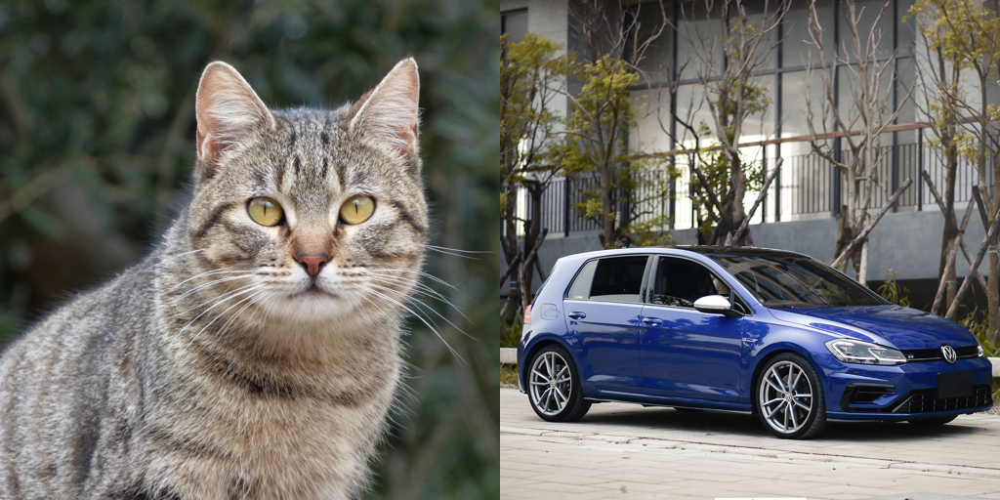

In [8]:
# extract a concept embedding
image_prompt = load_image("../images/cat.jpg")
image_prompt2 = load_image("../images/car.jpg")
# image_prompt = load_image("https://image-cdn.hypb.st/https%3A%2F%2Fhypebeast.com%2Fwp-content%2Fblogs.dir%2F6%2Ffiles%2F2022%2F10%2Fstudio-ghibli-hayao-miyazaki-new-movie-almost-finished-1.jpg?cbr=1&q=90")
from IPython.display import display
image_embeds = encode_image([image_prompt, image_prompt2], image_encoder, feature_extractor)
concept_embeds = concept_encoder(image_embeds.float())   
display(make_image_grid([image_prompt, image_prompt2], rows=1, cols=2, resize=512))

# Experiments

In [9]:
property_features = torch.load(os.path.join('../ckpts', 'property_features.pt'))
word_emb = property_features['text_features']
word_list = property_features['text']
label_concept = torch.load(os.path.join('../ckpts', 'label_dim.pt'))

# Image Editing

In [11]:
# num = 8
# concept_edited = ['old technology']
# ind_concept_edited = [label_concept.index(c) for c in concept_edited]
# values = torch.tensor([[0.0+i*0.15] for i in range(num)], device=device)
# num = [0, 2, 3, 7, 9, 11, 13, 15]
n = 16
concept_edited = ['cotton clothing']
ind_concept_edited = [label_concept.index(c) for c in concept_edited]
# values = [i*.15, (n-i)*.1, (n-i)*.03]
values = torch.tensor([[0.8+i*.1] for i in range(n)], device=device)

generators = [torch.Generator(device=device).manual_seed(1) for _ in range(n)]
seed_value = 0
for generator in generators:
    generator.manual_seed(seed_value)

from guidance_set import get_loss_dim, get_loss_smooth, get_loss_similarity, fns_collector
# Adjust loss functions to handle batched input
loss_dim = get_loss_dim(concept_encoder, ind_concept_edited, values)
loss_smooth = get_loss_smooth(n_diag=2, threshold=1)
loss_similarity = get_loss_similarity(h_target=image_embeds[0:1], threshold=1)

loss_func = fns_collector(
    fns=[
        loss_dim, 
        loss_smooth,
        loss_similarity,
    ],
    scales=[10, 3, 1]
)

# Generate all embeddings in one pass
h = pipe.generate_guidance(
    loss_fn=loss_func,
    num_inference_steps=50,
    num_resampling_steps=5,
    guidance_scale=0.5,
    generator=generators,
    use_ema=False,
    latent=None,
    strength=1,
    N=n,
    shape=(1024,)
)

# Generate all images in parallel
pipe_image.pipe.set_ip_adapter_scale(1)
text_prompt = 'well-formed, beautiful, correct proportions, high resolution, good anatomy, best quality, high quality.'
negative_prompt = "deformed, ugly, wrong proportion, low res, bad anatomy, worst quality, low quality"

from diffusers import AutoPipelineForText2Image, AutoPipelineForImage2Image
pipe_image.pipe = AutoPipelineForImage2Image.from_pipe(pipe_image.pipe).to("cuda")
images = []
for i in range(n):
    generators[i].manual_seed(seed_value)
    image = pipe_image.generate(
        h[i:i+1].to(dtype=torch.float16),
        image=image_prompt.resize((512, 512)),
        strength=0.5, 
        # text_prompt=text_prompt,
        # negative_prompt=negative_prompt,
        generator=generators[i],
        # guidance_scale=5,
    )
    images.append(image[0])

50it [00:06,  7.60it/s]
/home/weichen/miniconda3/envs/sd/lib/python3.11/site-packages/diffusers/configuration_utils.py:139: FutureWarning: Accessing config attribute `_name_or_path` directly via 'StableDiffusionXLImg2ImgPipeline' object attribute is deprecated. Please access '_name_or_path' over 'StableDiffusionXLImg2ImgPipeline's config object instead, e.g. 'scheduler.config._name_or_path'.
  deprecate("direct config name access", "1.0.0", deprecation_message, standard_warn=False)


  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

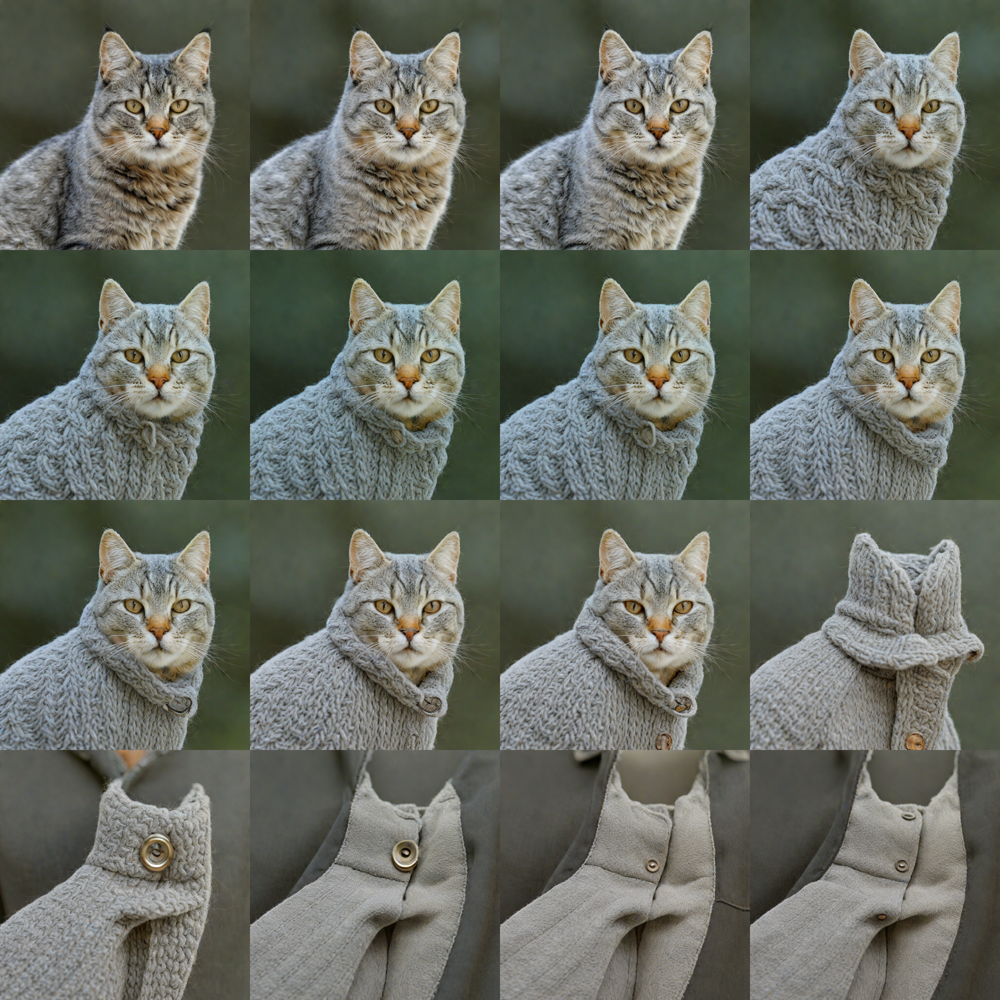

In [12]:
display(make_image_grid([*images], rows=4, cols=4, resize=512))

In [13]:
num = [0,4,8,10,11,12,14,15]

In [14]:
images_ = [images[i] for i in num]

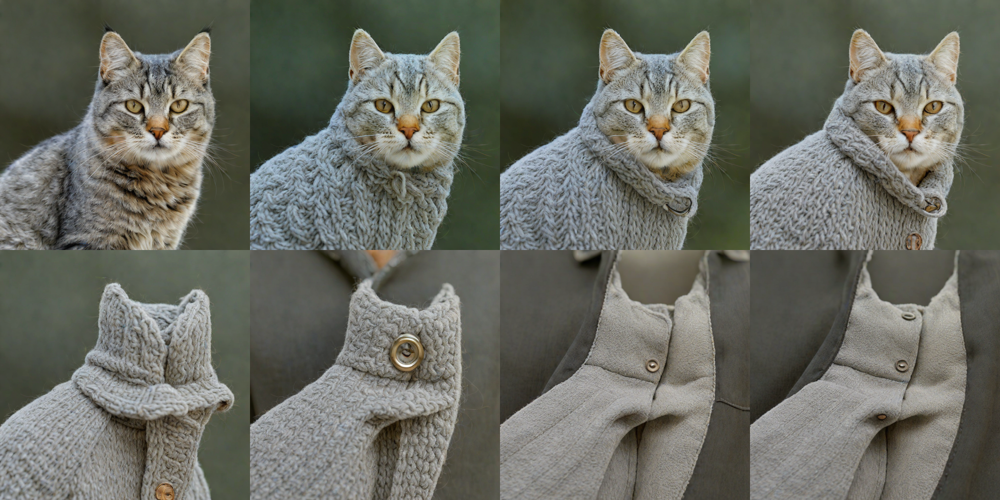

In [15]:
display(make_image_grid(images_, rows=2, cols=4, resize=512))

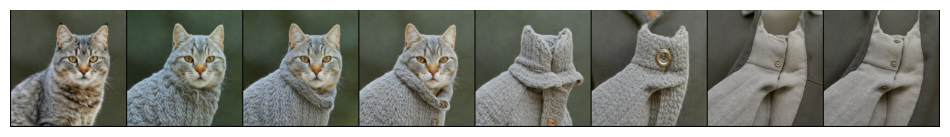

In [16]:
plot_indices_grid(images_, shape=(1,8))

In [17]:
h[num]

tensor([[-0.6721, -0.3475,  0.4655,  ..., -0.3139,  0.2874,  0.1400],
        [-0.6032,  0.0646, -0.0193,  ..., -0.0191, -0.3194,  0.1261],
        [-0.5727,  0.1029,  0.0752,  ...,  0.4062, -0.3557, -0.1286],
        ...,
        [-0.5068,  0.1428,  0.2460,  ...,  0.4650, -0.2952, -0.4073],
        [-0.4357,  0.1600,  0.2361,  ...,  0.3457, -0.2061, -0.4956],
        [-0.4312,  0.2016,  0.2115,  ...,  0.3507, -0.1906, -0.5057]],
       device='cuda:0')

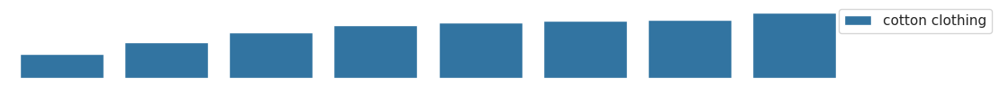

In [18]:
import seaborn as sns
import matplotlib.pyplot as plt

n = 8
xticks = list(range(n))

# image_embeds_pred = encode_image(images, image_encoder, feature_extractor)
h_ = h[num]
concept_embeds_h = concept_encoder(h_.float()) 
# concept_embeds_pred = concept_encoder(image_embeds_pred.float()) 
# values of the concept edited across the batch
## (B, len(concept_dims))
values_gen = concept_embeds_h[:, ind_concept_edited].detach().cpu()
values_gen = values_gen.tolist()

# create df for barplot, with xticks, value and concept
df = pd.DataFrame({'xticks': [i for i in xticks for _ in range(1)], 'value': [i for v in values_gen for i in v], 'concept': concept_edited*n})

# 创建折线图
sns.set(style="whitegrid")  # 设置Seaborn样式

plt.figure(figsize=(12, 1.))

# 绘制折线图
ax = sns.barplot(x='xticks', y='value', hue='concept', data=df, palette="tab10")



sns.despine(left=True, bottom=True)  # 移除左边和底部的轴线和边框

plt.xticks([])
plt.yticks([])
plt.xlabel('')
plt.ylabel('')

plt.legend(bbox_to_anchor=(0.99,1), loc=2, borderaxespad=0.)
plt.show()

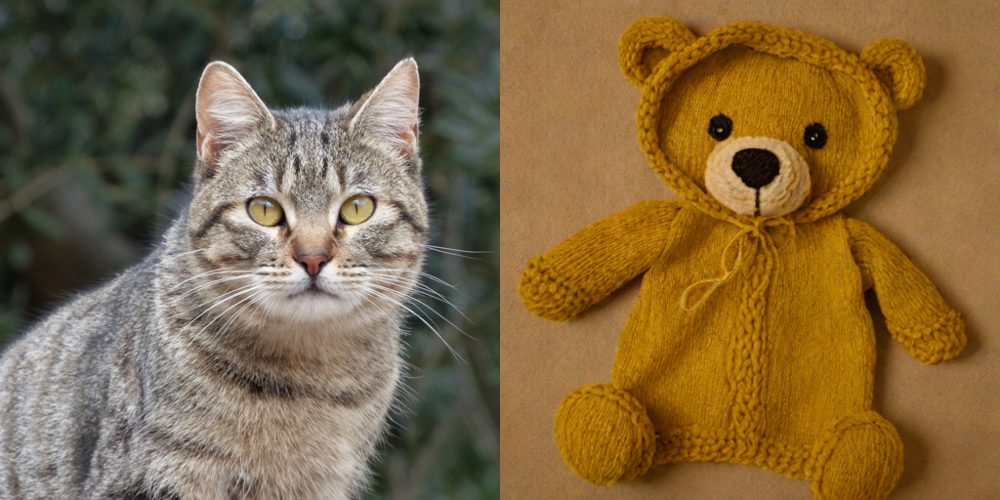

In [19]:
# extract a concept embedding
image_prompt = load_image("/mnt/dataset0/weichen/projects/visobj/proposals/mise/data/things-images/THINGSplus/images/images_resized/cat.jpg")
image_prompt2 = load_image("/mnt/dataset0/weichen/projects/visobj/proposals/mise/TrainingFreeGuidance4CE/figs/image_edit/teddy2.png")
# image_prompt = load_image("https://image-cdn.hypb.st/https%3A%2F%2Fhypebeast.com%2Fwp-content%2Fblogs.dir%2F6%2Ffiles%2F2022%2F10%2Fstudio-ghibli-hayao-miyazaki-new-movie-almost-finished-1.jpg?cbr=1&q=90")
from IPython.display import display
image_embeds = encode_image([image_prompt, image_prompt2], image_encoder, feature_extractor)
concept_embeds = concept_encoder(image_embeds.float())   
display(make_image_grid([image_prompt, image_prompt2], rows=1, cols=2, resize=512))

0it [00:00, ?it/s]

50it [00:05,  8.34it/s]
/home/weichen/miniconda3/envs/sd/lib/python3.11/site-packages/diffusers/configuration_utils.py:139: FutureWarning: Accessing config attribute `_name_or_path` directly via 'StableDiffusionXLImg2ImgPipeline' object attribute is deprecated. Please access '_name_or_path' over 'StableDiffusionXLImg2ImgPipeline's config object instead, e.g. 'scheduler.config._name_or_path'.
  deprecate("direct config name access", "1.0.0", deprecation_message, standard_warn=False)


  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

50it [00:05,  8.59it/s]


  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

50it [00:05,  8.64it/s]


  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

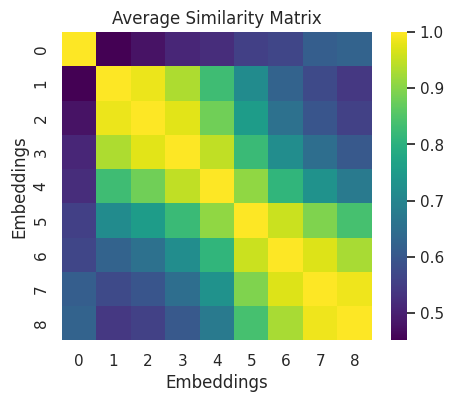

In [20]:
num = 8
concept_edited = ['ground animals', 'cotton clothing']
ind_concept_edited = [label_concept.index(c) for c in concept_edited]
values = torch.tensor([[0.5+i*.2, 1.5-i*.2] for i in range(num)], device=device)
n_generations = 3  # Number of generations to average over

# Adjust loss functions to handle batched input
loss_dim = get_loss_dim(concept_encoder, ind_concept_edited, values)
loss_smooth = get_loss_smooth(n_diag=2, threshold=1)
loss_similarity = get_loss_similarity(h_target=image_embeds[0:1], threshold=1)

loss_func = fns_collector(
    fns=[
        loss_dim, 
        loss_smooth,
        loss_similarity,
    ],
    scales=[10, 3, 1]
)

# Prepare to accumulate similarity matrices
sim_accumulate = torch.zeros((num+1, num+1), device=device)

for i in range(n_generations):
    seed_value = i
    # Prepare generators
    generators = [torch.Generator(device=device).manual_seed(seed_value) for _ in range(num)]
    for generator in generators:
        generator.manual_seed(seed_value)
        # Generate embeddings
    h = pipe.generate_guidance(
        loss_fn=loss_func,
        num_inference_steps=50,
        num_resampling_steps=5,
        guidance_scale=0.5,
        generator=generators,
        use_ema=False,
        latent=None,
        strength=1,
        N=num,
        shape=(1024,)
    )

    images = []
    for i in range(8):
        generators[i].manual_seed(seed_value)
        image = pipe_image.generate(
            h[i:i+1].to(dtype=torch.float16),
            image=image_prompt.resize((512, 512)),
            strength=0.5, 
            # text_prompt=text_prompt,
            # negative_prompt=negative_prompt,
            generator=generators[i],
            # guidance_scale=5,
        )
        images.append(image[0])

    h_ = encode_image(images, image_encoder, feature_extractor)

    h_9 = torch.cat([image_embeds[0:1], h], dim=0)

    # Normalize the embeddings to unit length
    h_norm = h_9 / h_9.norm(dim=1, keepdim=True)

    # Calculate the similarity matrix as the dot product of normalized embeddings
    sim = torch.mm(h_norm, h_norm.t())

    # Accumulate the similarity matrices
    sim_accumulate += sim

# Compute the average similarity matrix
average_sim = sim_accumulate / (n_generations)

# Convert the average similarity matrix to a numpy array for visualization
average_sim_np = average_sim.detach().cpu().numpy()

# Visualize the average similarity matrix using seaborn
plt.figure(figsize=(5, 4))
sns.heatmap(average_sim_np, cmap='viridis')
plt.title('Average Similarity Matrix')
plt.xlabel('Embeddings')
plt.ylabel('Embeddings')
plt.show()

In [21]:
h.cpu().detach()
h_.cpu().detach()

tensor([[-0.5747, -0.2031,  0.5449,  ...,  0.3164,  0.1641,  0.0538],
        [-0.0765,  0.3511,  0.3784,  ..., -0.3030,  0.2373, -0.0537],
        [ 0.0661,  0.3618,  0.2256,  ..., -0.4592,  0.0250, -0.0409],
        ...,
        [-0.4189, -0.9136,  0.6445,  ...,  0.6938,  0.4199,  0.7119],
        [-0.3530, -0.7939,  0.6074,  ...,  0.8755,  0.5166,  0.6445],
        [-0.2236, -0.5532,  0.7446,  ...,  0.8301,  0.5312,  0.6274]],
       dtype=torch.float16)

50it [00:05,  9.18it/s]
/home/weichen/miniconda3/envs/sd/lib/python3.11/site-packages/diffusers/configuration_utils.py:139: FutureWarning: Accessing config attribute `_name_or_path` directly via 'StableDiffusionXLImg2ImgPipeline' object attribute is deprecated. Please access '_name_or_path' over 'StableDiffusionXLImg2ImgPipeline's config object instead, e.g. 'scheduler.config._name_or_path'.
  deprecate("direct config name access", "1.0.0", deprecation_message, standard_warn=False)


  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

50it [00:06,  7.93it/s]


  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

50it [00:05,  8.57it/s]


  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

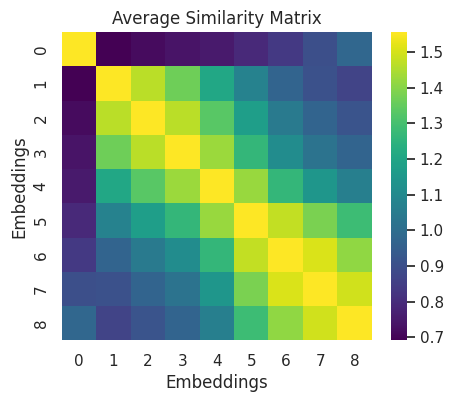

In [30]:
num = 8
concept_edited = ['ground animals', 'cotton clothing']
ind_concept_edited = [label_concept.index(c) for c in concept_edited]
values = torch.tensor([[0.5+i*.2, 1.5-i*.2] for i in range(num)], device=device)
n_generations = 3  # Number of generations to average over

# Adjust loss functions to handle batched input
loss_dim = get_loss_dim(concept_encoder, ind_concept_edited, values)
loss_smooth = get_loss_smooth(n_diag=2, threshold=1)
loss_similarity = get_loss_similarity(h_target=image_embeds[0:1], threshold=1)

loss_func = fns_collector(
    fns=[
        loss_dim, 
        loss_smooth,
        loss_similarity,
    ],
    scales=[10, 3, 0.5]
)

# Prepare to accumulate similarity matrices
# sim_accumulate = torch.zeros((num+1, num+1), device=device)

for i in range(n_generations):
    seed_value = i
    # Prepare generators
    generators = [torch.Generator(device=device).manual_seed(seed_value) for _ in range(num)]
    for generator in generators:
        generator.manual_seed(seed_value)
        # Generate embeddings
    h = pipe.generate_guidance(
        loss_fn=loss_func,
        num_inference_steps=50,
        num_resampling_steps=5,
        guidance_scale=0.5,
        generator=generators,
        use_ema=False,
        latent=None,
        strength=1,
        N=num,
        shape=(1024,)
    )

    images = []
    for i in range(8):
        generators[i].manual_seed(seed_value)
        image = pipe_image.generate(
            h[i:i+1].to(dtype=torch.float16),
            image=image_prompt.resize((512, 512)),
            strength=0.5, 
            # text_prompt=text_prompt,
            # negative_prompt=negative_prompt,
            generator=generators[i],
            # guidance_scale=5,
        )
        images.append(image[0])

    h_ = encode_image(images, image_encoder, feature_extractor)

    h_9 = torch.cat([image_embeds[0:1], h], dim=0).detach()

    # Normalize the embeddings to unit length
    h_norm = h_9 / h_9.norm(dim=1, keepdim=True)

    # Calculate the similarity matrix as the dot product of normalized embeddings
    sim = torch.mm(h_norm, h_norm.t())

    # Accumulate the similarity matrices
    sim_accumulate += sim

# Compute the average similarity matrix
average_sim = sim_accumulate / (n_generations+6)

# Convert the average similarity matrix to a numpy array for visualization
average_sim_np = average_sim.detach().cpu().numpy()

# Visualize the average similarity matrix using seaborn
plt.figure(figsize=(5, 4))
sns.heatmap(average_sim_np, cmap='viridis')
plt.title('Average Similarity Matrix')
plt.xlabel('Embeddings')
plt.ylabel('Embeddings')
plt.show()

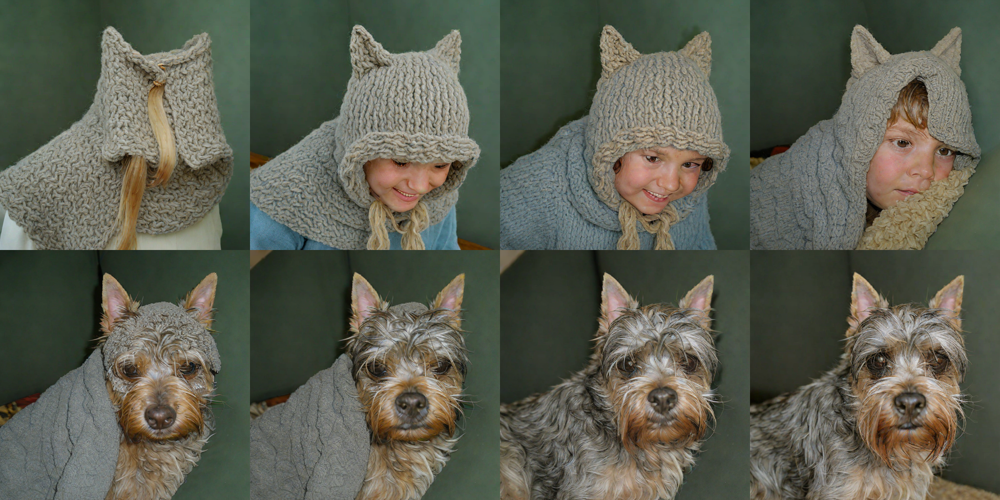

In [31]:
display(make_image_grid([*images], rows=2, cols=4, resize=512))

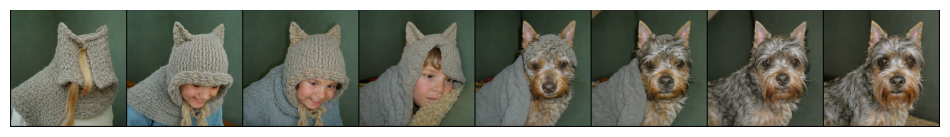

In [32]:
plot_indices_grid(images, shape=(1,8))

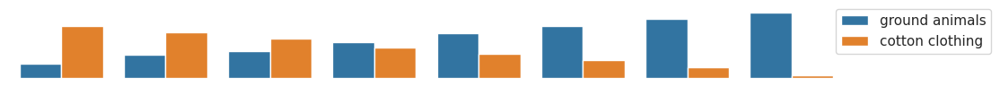

In [33]:
import seaborn as sns
import matplotlib.pyplot as plt

xticks = list(range(8))

# image_embeds_pred = encode_image(images, image_encoder, feature_extractor)
concept_embeds_h = concept_encoder(h.float()) 
# concept_embeds_pred = concept_encoder(image_embeds_pred.float()) 
# values of the concept edited across the batch
## (B, len(concept_dims))
values_gen = concept_embeds_h[:, ind_concept_edited].detach().cpu()
values_gen = values_gen.tolist()

# create df for barplot, with xticks, value and concept
df = pd.DataFrame({'xticks': [i for i in xticks for _ in range(2)], 'value': [i for v in values_gen for i in v], 'concept': concept_edited*8})

# 创建折线图
sns.set(style="whitegrid")  # 设置Seaborn样式

plt.figure(figsize=(12, 1.))

# 绘制折线图
ax = sns.barplot(x='xticks', y='value', hue='concept', data=df, palette="tab10")



sns.despine(left=True, bottom=True)  # 移除左边和底部的轴线和边框

plt.xticks([])
plt.yticks([])
plt.xlabel('')
plt.ylabel('')

plt.legend(bbox_to_anchor=(0.99,1), loc=2, borderaxespad=0.)
plt.show()

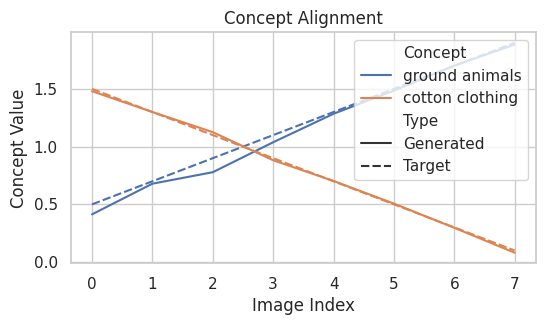

In [34]:
# Concept alignment ========================================

image_embeds_pred = encode_image(images, image_encoder, feature_extractor)
concept_embeds_h = concept_encoder(h.float()) 
concept_embeds_pred = concept_encoder(image_embeds_pred.float()) 

# values of the concept edited across the batch
## (B, len(concept_dims))
values_gen = concept_embeds_h[:, ind_concept_edited].detach().cpu()
values_tar = values.detach().cpu()

# line plot of values of generated images and target values, by seaborn
# for different concepts edited
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Assuming `num` is the number of images in the batch
num = values_gen.size(0)
# Create lists for values and types
values_all = values_gen.T.reshape(-1).tolist() + values_tar.T.reshape(-1).tolist()
types = ['Generated'] * values_gen.numel() + ['Target'] * values_tar.numel()

# Create a DataFrame for plotting
data = pd.DataFrame({
    'Value': values_all,
    'Type': types,
    'Concept': [concept for concept in concept_edited for _ in range(num)] * 2
})

# Plot using seaborn
plt.figure(figsize=(6, 3))
sns.lineplot(data=data, x=data.index % num, y='Value', style='Type', hue='Concept')
plt.title('Concept Alignment')
plt.xlabel('Image Index')
plt.ylabel('Concept Value')
plt.show()

## consistent and diversity

### single concept

In [ ]:
# num = 8
# concept_edited = ['household furniture']
# ind_concept_edited = [label_concept.index(c) for c in concept_edited]
# # set value to a+b*torch.rand(1) or a+b*torch.randn(1) to keep diversity for single concept
# values = torch.tensor([
#     [0.5 + 1*torch.rand(1)] 
#     for i in range(num)
# ], device=device)
# print('Concept values:', values)

# seed_value = 1
# generators = [torch.Generator(device=device).manual_seed(1) for _ in range(num)]
# seed_values = torch.randint(10000, (num, ), generator=torch.Generator(device=device).manual_seed(seed_value), device=device)
# print('Seed values:', seed_values)
# for seed, generator in zip(seed_values, generators):
#     generator.manual_seed(seed.item())

# # Adjust loss functions to handle batched input
# loss_dim = get_loss_dim(concept_encoder, ind_concept_edited, values)
# # loss_smooth = get_loss_smooth(n_diag=3, threshold=1)
# # loss_similarity = get_loss_similarity(h_target=image_embeds[1:2], threshold=1)

# loss_func = fns_collector(
#     fns=[
#         loss_dim, 
#         # loss_smooth,
#         # loss_similarity,
#     ],
#     scales=[1,]
# )


# # Generate all embeddings in one pass
# h = pipe.generate_guidance(
#     loss_fn=loss_func,
#     num_inference_steps=50,
#     num_resampling_steps=5,
#     guidance_scale=0.5,
#     generator=generators,
#     use_ema=False,
#     latent=None,
#     strength=1,
#     N=num,
#     shape=(1024,)
# )

# # Generate all images in parallel
# pipe_image.pipe.set_ip_adapter_scale(1)

# images = pipe_image.generate(
#     h.to(dtype=torch.float16),
#     generator=generators,
# )


Concept values: tensor([[1.1242],
        [0.5406],
        [1.2603],
        [1.3504],
        [1.1690],
        [1.3391],
        [1.3213],
        [1.0854]], device='cuda:0')
Seed values: tensor([4032, 6450, 5999,  127, 2256, 6366, 2011, 5281], device='cuda:0')


50it [00:03, 12.74it/s]
/home/jc/miniconda3/envs/torch/lib/python3.11/site-packages/diffusers/configuration_utils.py:139: FutureWarning: Accessing config attribute `_name_or_path` directly via 'StableDiffusionXLPipeline' object attribute is deprecated. Please access '_name_or_path' over 'StableDiffusionXLPipeline's config object instead, e.g. 'scheduler.config._name_or_path'.
  deprecate("direct config name access", "1.0.0", deprecation_message, standard_warn=False)


  0%|          | 0/4 [00:00<?, ?it/s]